In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import os
import plotly.express as px

In [2]:
excel_list = os.listdir(r"")
excel_list

['uber-raw-data-apr14.csv',
 'uber-raw-data-aug14.csv',
 'uber-raw-data-janjune-15.csv',
 'uber-raw-data-jul14.csv',
 'uber-raw-data-jun14.csv',
 'uber-raw-data-may14.csv',
 'uber-raw-data-sep14.csv']

In [3]:
excel_list.remove('uber-raw-data-janjune-15.csv')

In [4]:
excel_list

['uber-raw-data-apr14.csv',
 'uber-raw-data-aug14.csv',
 'uber-raw-data-jul14.csv',
 'uber-raw-data-jun14.csv',
 'uber-raw-data-may14.csv',
 'uber-raw-data-sep14.csv']

In [5]:
##Reading Data

In [6]:
path = r""

In [7]:
df = pd.DataFrame()
for csv in excel_list:
    temp = pd.read_csv(path + '/'+csv)
    df = pd.concat([df,temp])

In [8]:
df_test = df

In [9]:
df_test.dtypes

Date/Time     object
Lat          float64
Lon          float64
Base          object
dtype: object

In [10]:
df_test['Date/Time'] = pd.to_datetime(df_test['Date/Time'])

In [11]:
df_test.dtypes

Date/Time    datetime64[ns]
Lat                 float64
Lon                 float64
Base                 object
dtype: object

In [12]:
##Extracting Features From DateTime

In [13]:
df_test['Day Name'] = df_test['Date/Time'].dt.day_name()

In [14]:
df_test['Day'] = df_test['Date/Time'].dt.day

In [15]:
df_test['Year'] = df_test['Date/Time'].dt.year

In [16]:
df_test['Month'] = df_test['Date/Time'].dt.month

In [17]:
df_test['Hour'] = df_test['Date/Time'].dt.hour

In [18]:
df_test['Minute'] = df_test['Date/Time'].dt.minute

In [19]:
df_test.head()

,Date/Time,Lat,Lon,Base,Day Name,Day,Year,Month,Hour,Minute
0,2014-04-01 00:11:00,40.7690,-73.9549,B02512,Tuesday,1,2014,4,0,11
1,2014-04-01 00:17:00,40.7267,-74.0345,B02512,Tuesday,1,2014,4,0,17
2,2014-04-01 00:21:00,40.7316,-73.9873,B02512,Tuesday,1,2014,4,0,21
3,2014-04-01 00:28:00,40.7588,-73.9776,B02512,Tuesday,1,2014,4,0,28
4,2014-04-01 00:33:00,40.7594,-73.9722,B02512,Tuesday,1,2014,4,0,33


In [20]:
##Analysing Uber Rides by WeekDays

In [21]:
df_test['Day Name'].value_counts()

Thursday     755145
Friday       741139
Wednesday    696488
Tuesday      663789
Saturday     646114
Monday       541472
Sunday       490180
Name: Day Name, dtype: int64

In [22]:
px.bar(x= df_test['Day Name'].value_counts().index , y = df_test['Day Name'].value_counts())

In [23]:
## Analysis of Uber Rides on the basis of Hour

In [24]:
df_test['Hour'].value_counts()

17    336190
18    324679
16    313400
19    294513
20    284604
21    281460
15    275466
22    241858
14    230625
13    195877
7     193094
8     190504
12    170452
23    169190
11    165703
9     159967
10    159148
6     143213
0     103836
5      83939
1      67227
4      55230
3      48287
2      45865
Name: Hour, dtype: int64

In [25]:
px.bar( x = df_test['Hour'].value_counts().index , y = df_test['Hour'].value_counts())

In [26]:
df_test[df_test['Month'] == 4]['Hour'].value_counts()

17    45475
18    43003
16    42003
19    38923
21    36964
20    36244
15    35324
22    30645
14    27190
7     24924
8     22843
13    22603
23    20649
12    19425
11    18774
6     18498
9     17939
10    17865
0     11910
5      9476
1      7769
4      6095
3      5040
2      4935
Name: Hour, dtype: int64

In [27]:
unique_month = df_test['Month'].unique()
unique_month

array([4, 8, 7, 6, 5, 9], dtype=int64)

4


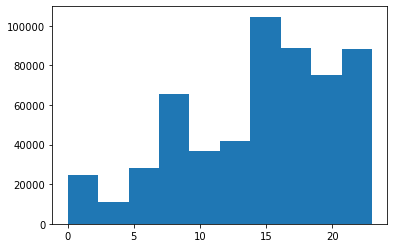

8


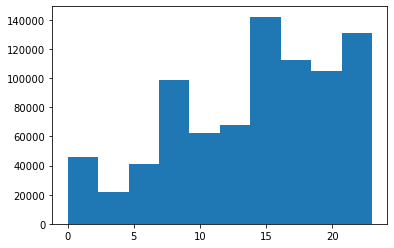

7


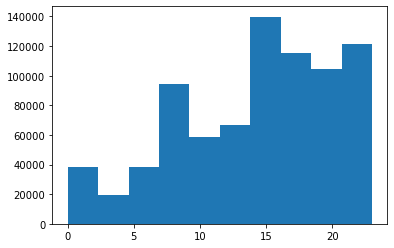

6


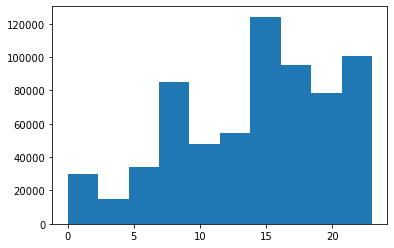

5


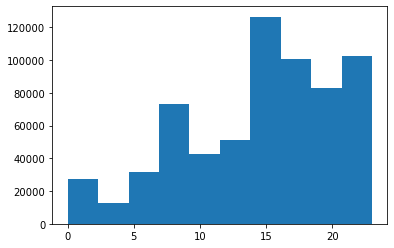

9


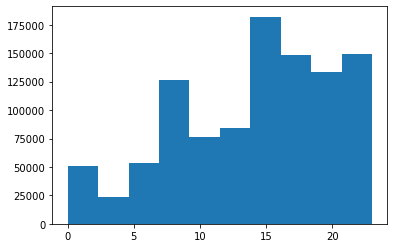

In [28]:
for i in unique_month:
    print(i)
    plt.hist(x = df_test[df_test['Month'] == i]['Hour'])
    plt.show()

In [29]:
##Analysis Uber rides on the basis of Month

In [30]:
df_test['Month'].value_counts()

9    1028136
8     829275
7     796121
6     663844
5     652435
4     564516
Name: Month, dtype: int64

In [31]:
plt.figure(figsize  = (10,10))
px.bar(x = df_test['Month'].value_counts().index ,y = df_test['Month'].value_counts())

<Figure size 720x720 with 0 Axes>

In [32]:
##Analysis of Journey of Each Day

In [33]:
df_test.groupby('Day')['Month'].count()

Day
1     127430
2     143201
3     142983
4     140923
5     147054
6     139886
7     143503
8     145984
9     155135
10    152500
11    148860
12    160606
13    156892
14    140148
15    153726
16    158921
17    152524
18    151319
19    153088
20    144179
21    141112
22    146952
23    156032
24    144169
25    152667
26    153405
27    145652
28    141157
29    149086
30    167160
31     78073
Name: Month, dtype: int64

In [34]:
px.bar(x = df_test['Day'].unique() , y = df_test.groupby('Day')['Month'].count())

<AxesSubplot:xlabel='Hour', ylabel='Lat'>

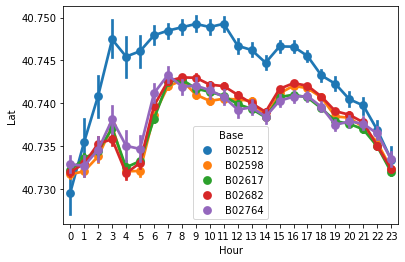

In [35]:
sns.pointplot(x = 'Hour' , y = 'Lat' , data = df_test , hue = "Base")

In [36]:
df_test.groupby('Base').count()['Month']

Base
B02512     205673
B02598    1393113
B02617    1458853
B02682    1212789
B02764     263899
Name: Month, dtype: int64

<AxesSubplot:xlabel='Month', ylabel='Hour'>

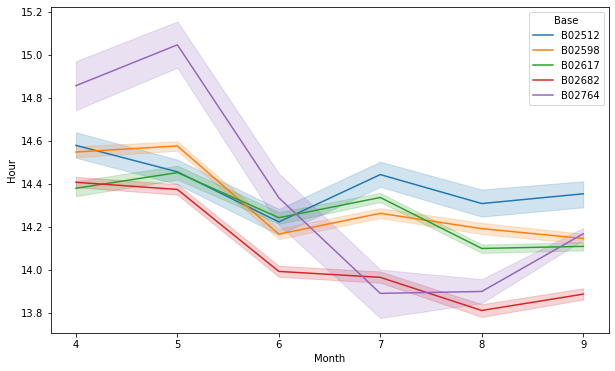

In [37]:
plt.figure(figsize = (10,6))
sns.lineplot(x = 'Month' , y = "Hour" , hue = "Base" ,data = df_test)

In [151]:
base = df_test.groupby(['Month' , 'Base'])['Date/Time'].count().reset_index()

In [153]:
hour_week = df_test.groupby(["Day Name" , "Hour"])['Date/Time'].count()
hour_week

Day Name   Hour
Friday     0       13716
           1        8163
           2        5350
           3        6930
           4        8806
                   ...  
Wednesday  19      47017
           20      47772
           21      44553
           22      32868
           23      18146
Name: Date/Time, Length: 168, dtype: int64

In [154]:
hour_week.unstack()

Hour,0,1,2,3,4,5,6,7,8,9,...,14,15,16,17,18,19,20,21,22,23
Day Name,,,,,,,,,,,,,,,,,,,,,
Friday,13716,8163,5350,6930,8806,13450,23412,32061,31509,25230,...,36206,43673,48169,51961,54762,49595,43542,48323,49409,41260
Monday,6436,3737,2938,6232,9640,15032,23746,31159,29265,22197,...,28157,32744,38770,42023,37000,34159,32849,28925,20158,11811
Saturday,27633,19189,12710,9542,6846,7084,8579,11014,14411,17669,...,31418,38769,43512,42844,45883,41098,38714,43826,47951,43174
Sunday,32877,23015,15436,10597,6374,6169,6596,8728,12128,16401,...,28151,31112,33038,31521,28291,25948,25076,23967,19566,12166
Thursday,9293,5290,3719,5637,8505,14169,27065,37038,35431,27812,...,36699,44442,50560,56704,55825,51907,51990,51953,44194,27764
Tuesday,6237,3509,2571,4494,7548,14241,26872,36599,33934,25023,...,34846,41338,48667,55500,50186,44789,44661,39913,27712,14869
Wednesday,7644,4324,3141,4855,7511,13794,26943,36495,33826,25635,...,35148,43388,50684,55637,52732,47017,47772,44553,32868,18146


<AxesSubplot:xlabel='Hour', ylabel='Day Name'>

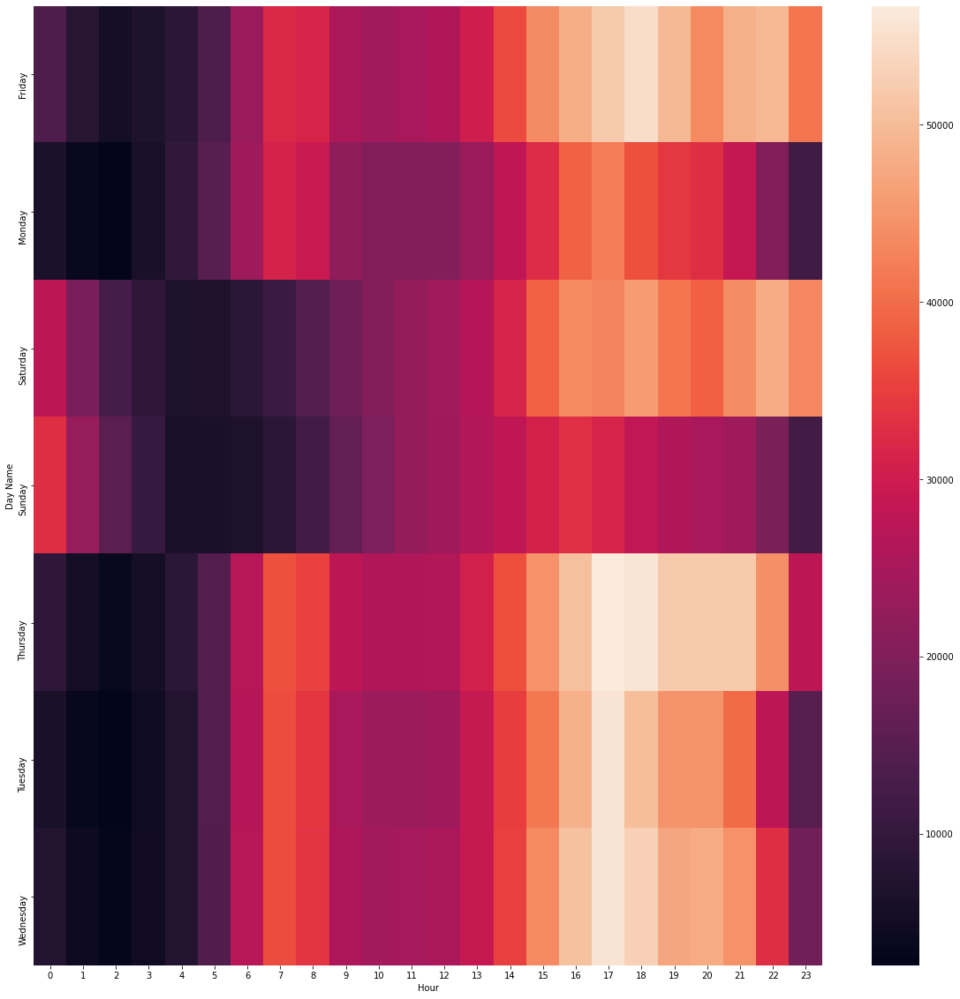

In [160]:
plt.figure(figsize = (20,20))
sns.heatmap(hour_week.unstack())

<AxesSubplot:xlabel='Hour', ylabel='Date/Time'>

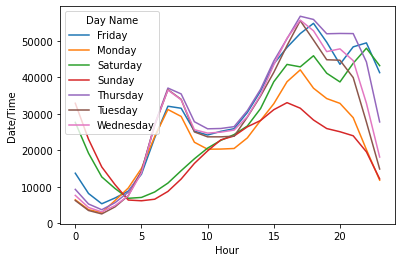

In [117]:
sns.lineplot(x = hour_week['Hour'], y = hour_week['Date/Time'] , hue = hour_week['Day Name'])

In [118]:
unique_month = df_test['Month'].unique()
unique_month

array([4, 8, 7, 6, 5, 9], dtype=int64)

4


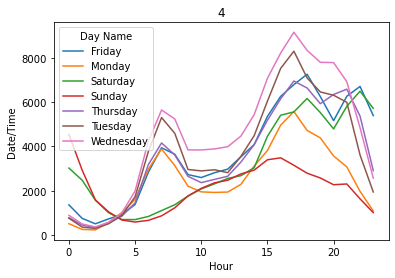

8


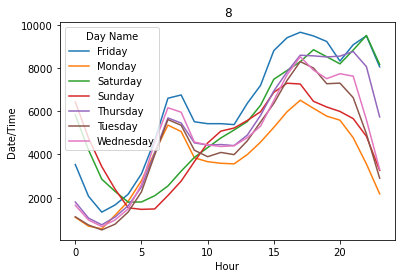

7


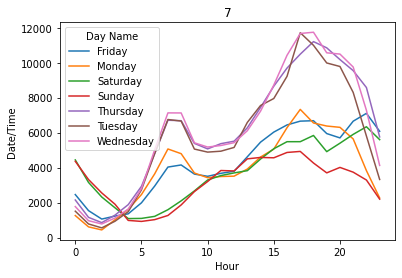

6


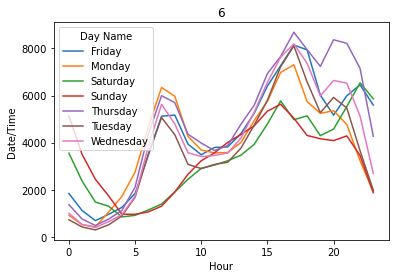

5


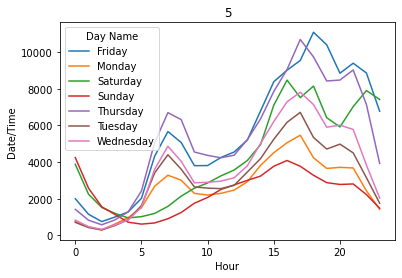

9


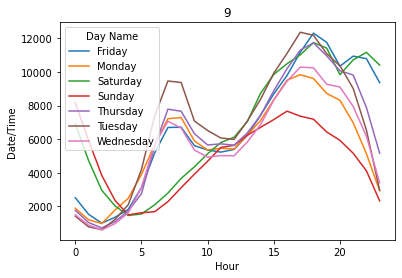

In [119]:
for i in unique_month:
    data = df_test[df_test['Month'] == i]
    data
    print(i)
    base = data.groupby(["Day Name" , "Hour"])['Date/Time'].count().reset_index()
    base
    sns.lineplot(x = base['Hour'], y = base['Date/Time'] , hue = base['Day Name'])
    plt.title(i)
    plt.show()

In [120]:
location = df_test.groupby(["Lat" , "Lon"])['Base'].count().reset_index()


In [121]:
location

,Lat,Lon,Base
0,39.6569,-74.2258,1
1,39.6686,-74.1607,1
2,39.7214,-74.2446,1
3,39.8416,-74.1512,1
4,39.9055,-74.0791,1
...,...,...,...
574553,41.3730,-72.9237,1
574554,41.3737,-73.7988,1
574555,41.5016,-72.8987,1
574556,41.5276,-72.7734,2


In [122]:
import folium
from folium.plugins import HeatMap

In [123]:
maps = folium.Map()

In [124]:
HeatMap(location).add_to(maps)
maps

In [125]:
df_test.shape

(4534327, 10)

In [126]:
#Spatial Analysis on the Basis of Weekday

In [162]:
unique_day = df_test['Day Name'].unique()

In [161]:
unique_day

array(['Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday',
       'Monday'], dtype=object)

In [168]:
def maps(df_test ,day):
    maps = folium.Map()
    data = df_test[df_test['Day Name'] == day]
    location = data.groupby(["Lat" , "Lon"])['Base'].count().reset_index()
    HeatMap(location , radius = 12).add_to(maps)
    return maps

In [169]:
maps(df_test , day = "Sunday")

In [68]:
df2 = pd.read_csv(r"")

In [69]:
df2.dtypes

Dispatching_base_num    object
Pickup_date             object
Affiliated_base_num     object
locationID               int64
dtype: object

In [70]:
df2['Date'] = pd.to_datetime(df2['Pickup_date'])

In [71]:
df2 = df2.drop('Pickup_date' , axis = 1)

In [72]:
df2['Day'] = df2['Date'].dt.day_name()

In [73]:
df2['Month'] = df2['Date'].dt.month

In [74]:
df2['Year'] = df2['Date'].dt.year

In [75]:
df2['Dates'] = df2['Date'].dt.day

In [77]:
df2.drop('Date' , axis = 1)

,Dispatching_base_num,Affiliated_base_num,locationID,Day,Month,Year,Dates
0,B02617,B02617,141,Sunday,5,2015,17
1,B02617,B02617,65,Sunday,5,2015,17
2,B02617,B02617,100,Sunday,5,2015,17
3,B02617,B02774,80,Sunday,5,2015,17
4,B02617,B02617,90,Sunday,5,2015,17
...,...,...,...,...,...,...,...
14270474,B02765,B02765,186,Friday,5,2015,8
14270475,B02765,B02765,263,Friday,5,2015,8
14270476,B02765,B02765,90,Friday,5,2015,8
14270477,B02765,B01899,45,Friday,5,2015,8


In [78]:
df2['base_num_comb'] = df2['Dispatching_base_num']+ "-" + df2['Affiliated_base_num']

In [ ]:
#Most visted Base Combination

In [84]:
df2 = df2.drop(['Dispatching_base_num' , 'Affiliated_base_num'] , axis = 1)

In [106]:
base_com = df2.groupby('base_num_comb').count().sort_values(by = 'Year' ,ascending = False).head(8)
base_com

,locationID,Date,Day,Month,Year,Dates
base_num_comb,,,,,,
B02764-B02764,3878453,3878453,3878453,3878453,3878453,3878453
B02682-B02682,2896500,2896500,2896500,2896500,2896500,2896500
B02617-B02617,1736760,1736760,1736760,1736760,1736760,1736760
B02598-B02598,1173719,1173719,1173719,1173719,1173719,1173719
B02765-B02765,765624,765624,765624,765624,765624,765624
B02764-B02682,299587,299587,299587,299587,299587,299587
B02682-B02764,198068,198068,198068,198068,198068,198068
B02512-B02512,146279,146279,146279,146279,146279,146279


In [104]:
#Top 8 Most Travelled Base Combination

In [111]:
plt.figure(figsize = (40,40))
px.bar(data_frame = base_com , x= "Year")

<Figure size 2880x2880 with 0 Axes>

In [170]:
df3 = pd.read_csv(r"")

In [171]:
df3

,dispatching_base_number,date,active_vehicles,trips
0,B02512,1/1/2015,190,1132
1,B02765,1/1/2015,225,1765
2,B02764,1/1/2015,3427,29421
3,B02682,1/1/2015,945,7679
4,B02617,1/1/2015,1228,9537
...,...,...,...,...
349,B02764,2/28/2015,3952,39812
350,B02617,2/28/2015,1372,14022
351,B02682,2/28/2015,1386,14472
352,B02512,2/28/2015,230,1803


In [172]:
#which base has most active vehicle

In [176]:
df3['dispatching_base_number'].unique()

array(['B02512', 'B02765', 'B02764', 'B02682', 'B02617', 'B02598'],
      dtype=object)

In [178]:
px.box(data_frame  = df3 , x = "dispatching_base_number"  , y = "active_vehicles")

In [179]:
# Which bse has most Trips

In [180]:
px.box(data_frame  = df3 , x = "dispatching_base_number"  , y = "trips")

In [181]:
df3.dtypes

dispatching_base_number    object
date                       object
active_vehicles             int64
trips                       int64
dtype: object

In [186]:
df3['Date'] = pd.to_datetime(df3['date'])
df3.drop('date' , axis = 1)
df3['Day'] = df3['Date'].dt.day_name()
df3['Month'] = df3['Date'].dt.month
df3['Year'] = df3['Date'].dt.year
df3['Dates'] = df3['Date'].dt.day
df3

,dispatching_base_number,date,active_vehicles,trips,Date,Day,Month,Year,Dates
0,B02512,1/1/2015,190,1132,2015-01-01,Thursday,1,2015,1
1,B02765,1/1/2015,225,1765,2015-01-01,Thursday,1,2015,1
2,B02764,1/1/2015,3427,29421,2015-01-01,Thursday,1,2015,1
3,B02682,1/1/2015,945,7679,2015-01-01,Thursday,1,2015,1
4,B02617,1/1/2015,1228,9537,2015-01-01,Thursday,1,2015,1
...,...,...,...,...,...,...,...,...,...
349,B02764,2/28/2015,3952,39812,2015-02-28,Saturday,2,2015,28
350,B02617,2/28/2015,1372,14022,2015-02-28,Saturday,2,2015,28
351,B02682,2/28/2015,1386,14472,2015-02-28,Saturday,2,2015,28
352,B02512,2/28/2015,230,1803,2015-02-28,Saturday,2,2015,28


In [204]:
df3.groupby('dispatching_base_number').

In [230]:
df3
grouped_trips = df3.groupby(['dispatching_base_number' , 'Date']).sum()['trips' ].reset_index()

grouped_trips

,dispatching_base_number,Date,trips
0,B02512,2015-01-01,1132
1,B02512,2015-01-02,875
2,B02512,2015-01-03,1088
3,B02512,2015-01-04,791
4,B02512,2015-01-05,984
...,...,...,...
349,B02765,2015-02-24,6390
350,B02765,2015-02-25,6178
351,B02765,2015-02-26,6744
352,B02765,2015-02-27,7563


In [231]:
grouped_vehicles = df3.groupby(['dispatching_base_number' , 'Date']).sum()['active_vehicles'].reset_index()
grouped_vehicles 

,dispatching_base_number,Date,active_vehicles
0,B02512,2015-01-01,190
1,B02512,2015-01-02,175
2,B02512,2015-01-03,173
3,B02512,2015-01-04,147
4,B02512,2015-01-05,194
...,...,...,...
349,B02765,2015-02-24,698
350,B02765,2015-02-25,706
351,B02765,2015-02-26,745
352,B02765,2015-02-27,786


<AxesSubplot:xlabel='Date', ylabel='active_vehicles'>

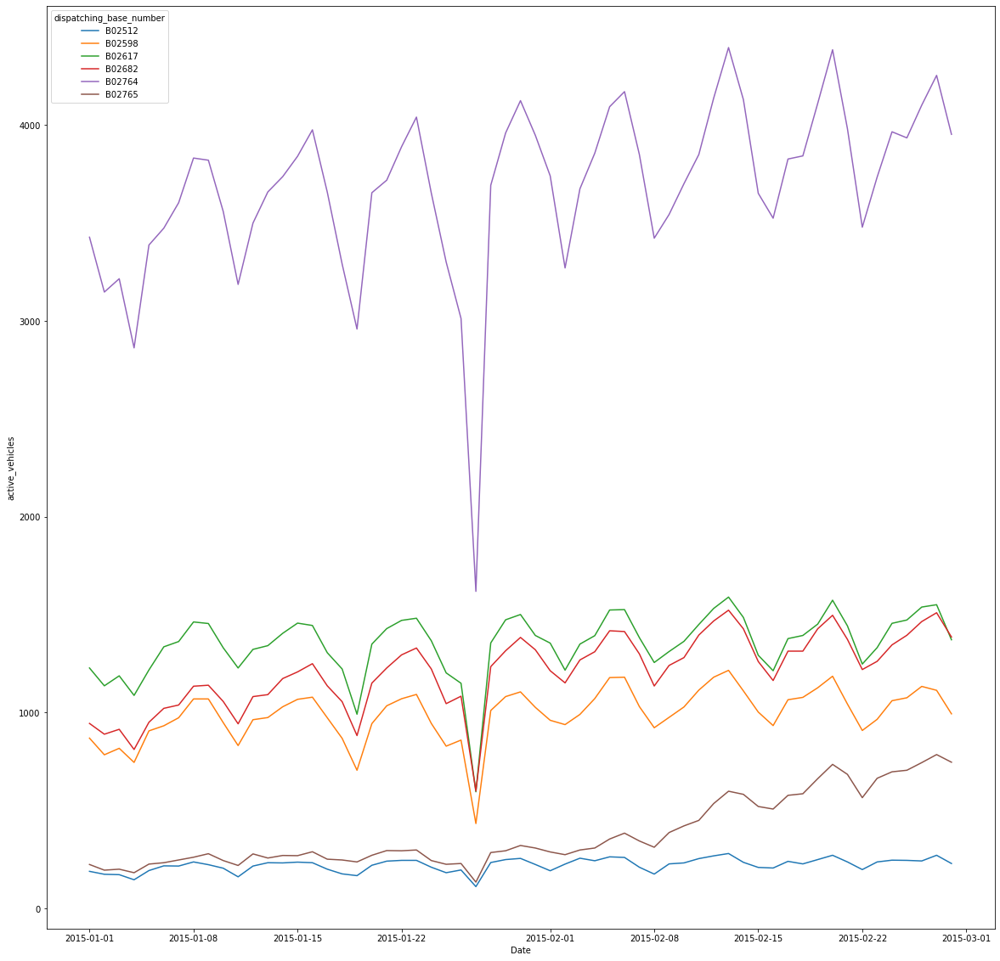

In [232]:
plt.figure(figsize = (20,20))
sns.lineplot(data = grouped_vehicles , x = 'Date' , y = 'active_vehicles' , hue = 'dispatching_base_number')

<AxesSubplot:xlabel='Date', ylabel='trips'>

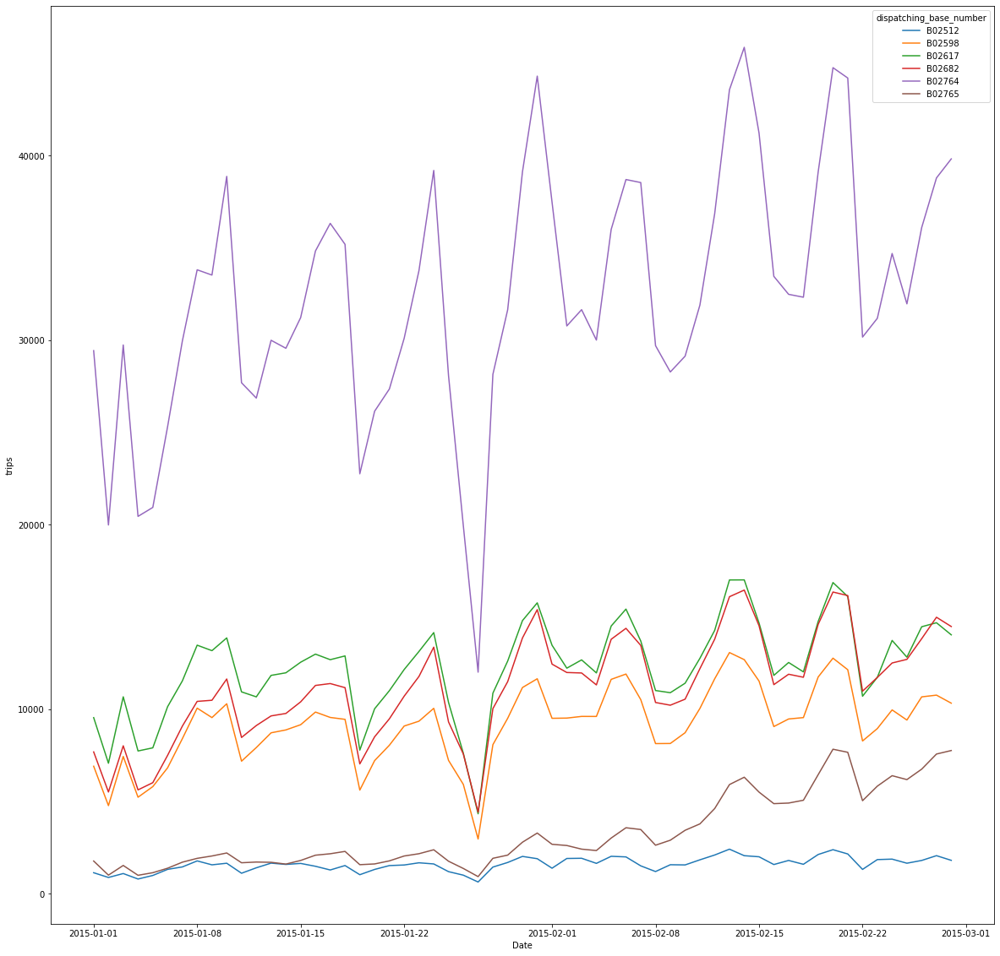

In [233]:
plt.figure(figsize = (20,20))
sns.lineplot(data = grouped_trips , x = 'Date' , y = 'trips' , hue = 'dispatching_base_number')

In [234]:
#Productivity of Each Base

In [229]:
df3

,dispatching_base_number,date,active_vehicles,trips,Date,Day,Month,Year,Dates
0,B02512,1/1/2015,190,1132,2015-01-01,Thursday,1,2015,1
1,B02765,1/1/2015,225,1765,2015-01-01,Thursday,1,2015,1
2,B02764,1/1/2015,3427,29421,2015-01-01,Thursday,1,2015,1
3,B02682,1/1/2015,945,7679,2015-01-01,Thursday,1,2015,1
4,B02617,1/1/2015,1228,9537,2015-01-01,Thursday,1,2015,1
...,...,...,...,...,...,...,...,...,...
349,B02764,2/28/2015,3952,39812,2015-02-28,Saturday,2,2015,28
350,B02617,2/28/2015,1372,14022,2015-02-28,Saturday,2,2015,28
351,B02682,2/28/2015,1386,14472,2015-02-28,Saturday,2,2015,28
352,B02512,2/28/2015,230,1803,2015-02-28,Saturday,2,2015,28


In [248]:
productivity = df3.groupby(['dispatching_base_number' , 'Month']).median()[['active_vehicles','trips']]

In [249]:
productivity

active_vehicles    trips
dispatching_base_number Month                          
B02512                  1                217.0   1446.0
                        2                239.5   1837.5
B02598                  1                964.0   8397.0
                        2               1063.5   9994.0
B02617                  1               1342.0  11528.0
                        2               1393.5  13573.0
B02682                  1               1092.0   9629.0
                        2               1330.0  12595.0
B02764                  1               3652.0  29729.0
                        2               3852.5  35338.0
B02765                  1                252.0   1765.0
                        2                551.0   4970.5

In [250]:
productivity['productivity'] = productivity['trips']/productivity['active_vehicles']

In [255]:
productivity.sort_values(by = 'productivity' , ascending = False)

,,active_vehicles,trips,productivity
dispatching_base_number,Month,,,
B02617,2,1393.5,13573.0,9.740222
B02682,2,1330.0,12595.0,9.469925
B02598,2,1063.5,9994.0,9.397273
B02764,2,3852.5,35338.0,9.172745
B02765,2,551.0,4970.5,9.020871
B02682,1,1092.0,9629.0,8.817766
B02598,1,964.0,8397.0,8.710581
B02617,1,1342.0,11528.0,8.590164
B02764,1,3652.0,29729.0,8.140471
